<a href="https://colab.research.google.com/github/anjali-rgpt/NLP-Projects/blob/main/Natural_Language_Processing_Case_Study.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Step 1: Get one data element, such as a book or a document.

In [ ]:
import nltk
import gensim
from nltk.corpus import brown
from nltk.corpus import gutenberg

from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
import re

from gensim import models, corpora

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import spacy

In [ ]:
nltk.download('gutenberg')
nltk.download('brown')

[nltk_data] Downloading package gutenberg to /root/nltk_data...
[nltk_data]   Unzipping corpora/gutenberg.zip.
[nltk_data] Downloading package brown to /root/nltk_data...
[nltk_data]   Unzipping corpora/brown.zip.


True

In [ ]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
gutenberg_files=nltk.corpus.gutenberg.fileids()

In [ ]:
gutenberg_files

['austen-emma.txt',
 'austen-persuasion.txt',
 'austen-sense.txt',
 'bible-kjv.txt',
 'blake-poems.txt',
 'bryant-stories.txt',
 'burgess-busterbrown.txt',
 'carroll-alice.txt',
 'chesterton-ball.txt',
 'chesterton-brown.txt',
 'chesterton-thursday.txt',
 'edgeworth-parents.txt',
 'melville-moby_dick.txt',
 'milton-paradise.txt',
 'shakespeare-caesar.txt',
 'shakespeare-hamlet.txt',
 'shakespeare-macbeth.txt',
 'whitman-leaves.txt']

In [ ]:
brown_genres=nltk.corpus.brown.categories()

In [ ]:
brown_genres

['adventure',
 'belles_lettres',
 'editorial',
 'fiction',
 'government',
 'hobbies',
 'humor',
 'learned',
 'lore',
 'mystery',
 'news',
 'religion',
 'reviews',
 'romance',
 'science_fiction']

Since we are looking at books, let us filter out the irrelevant categories in the Brown corpus.

In [ ]:
to_remove=['belles_lettres','editorial','news','reviews','government']
brown_genres_new=[]
for genre in brown_genres:
  if genre not in to_remove:
    brown_genres_new.append(genre)
  

In [ ]:
brown_genres_new

['adventure',
 'fiction',
 'hobbies',
 'humor',
 'learned',
 'lore',
 'mystery',
 'religion',
 'romance',
 'science_fiction']

In [ ]:
allfileids=[]
browncounts,gutcounts=0,len(gutenberg_files)
for genre in brown_genres_new:
  allfileids.extend(brown.fileids(genre))
  browncounts+=len(brown.fileids(genre))
allfileids.extend(gutenberg_files)

In [ ]:
# temp=[]
# corpus_lengths=[]

# for fileval in allfileids[:browncounts]:
#   doc=' '.join(brown.words(fileval))
#   tokenvals=nltk.word_tokenize(doc)
#   corpus_lengths.append(len(tokenvals))

# for fileval in allfileids[browncounts:]:
#   doc=' '.join(gutenberg.words(fileval))
#   tokenvals=nltk.word_tokenize(doc)
#   corpus_lengths.append(len(tokenvals))
  
# # mean_val=np.mean(corpus_lengths)
# # stddev=np.std(corpus_lengths)

# # for i in range(len(allfileids)):
# #   if corpus_lengths[i]>(mean_val+2*stddev) or corpus_lengths[i]<(mean_val-2*stddev):
# #     continue
  
# #   temp.append(allfileids[i])

# maxlen=max(corpus_lengths)
# ind=corpus_lengths.index(maxlen)



# allfileids.pop(ind)
# print(np.argmax(corpus_lengths))
# corpus_lengths

In [ ]:
print("Number of files or documents to be considered:",len(allfileids))

Number of files or documents to be considered: 325


##For our consideration, let's take Hamlet and Macbeth. 

In [ ]:
hamlet=gutenberg.raw('shakespeare-hamlet.txt')
macbeth=gutenberg.raw('shakespeare-macbeth.txt')

In [ ]:
hamlet

"[The Tragedie of Hamlet by William Shakespeare 1599]\n\n\nActus Primus. Scoena Prima.\n\nEnter Barnardo and Francisco two Centinels.\n\n  Barnardo. Who's there?\n  Fran. Nay answer me: Stand & vnfold\nyour selfe\n\n   Bar. Long liue the King\n\n   Fran. Barnardo?\n  Bar. He\n\n   Fran. You come most carefully vpon your houre\n\n   Bar. 'Tis now strook twelue, get thee to bed Francisco\n\n   Fran. For this releefe much thankes: 'Tis bitter cold,\nAnd I am sicke at heart\n\n   Barn. Haue you had quiet Guard?\n  Fran. Not a Mouse stirring\n\n   Barn. Well, goodnight. If you do meet Horatio and\nMarcellus, the Riuals of my Watch, bid them make hast.\nEnter Horatio and Marcellus.\n\n  Fran. I thinke I heare them. Stand: who's there?\n  Hor. Friends to this ground\n\n   Mar. And Leige-men to the Dane\n\n   Fran. Giue you good night\n\n   Mar. O farwel honest Soldier, who hath relieu'd you?\n  Fra. Barnardo ha's my place: giue you goodnight.\n\nExit Fran.\n\n  Mar. Holla Barnardo\n\n   Bar. 

#Step 2: Preprocessing

In [ ]:
#TOKENIZATION


In [ ]:
def tokenization(corpus):
  return nltk.word_tokenize(corpus.lower())

In [ ]:
print(tokenization(hamlet)[:10])

['[', 'the', 'tragedie', 'of', 'hamlet', 'by', 'william', 'shakespeare', '1599', ']']


In [ ]:
print(tokenization(macbeth)[:10])

['[', 'the', 'tragedie', 'of', 'macbeth', 'by', 'william', 'shakespeare', '1603', ']']


Based on the text, both seem to be tragedies. How are they related? Do they have similar themes?

In [ ]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
stop_eng=stopwords.words('english')
stop_eng.extend(['the','an','a', 'would', 'which', 'could', 'one', 'should', 'where', 'there', 'their'])
regex='[a-zA-Z\-][a-zA-Z\-]{2,}'

In [ ]:
def cleaning(tokens, stop):
  #print(re.match(regex,tokens[0].lower()))
  text=[word for word in tokens if word not in stop and re.match(regex,word)]
  #text=[word for word in text if len(word)>=4]
  print('and' in text)
  return text

In [ ]:
def document_joining(fileid_list):  #specific to this application
  documents=[]
  for fileid in fileid_list[:browncounts]:
    doc=' '.join(brown.words(fileid))
    documents.append(doc)
  for fileid in fileid_list[browncounts:]:
    doc=' '.join(gutenberg.words(fileid))
    documents.append(doc)
  return documents


In [ ]:
def create_pipeline(corpus, stop):
  cleaned_data=[]
  for document in corpus:
    print("\n----\nDocument Name:", document)
    step1=tokenization(document)
    print("\nTokens:", step1)
    step2=cleaning(step1,stop)
    print("\nCleaned:", step2)
    cleaned_data.append(step2)
  return cleaned_data
  

In [ ]:
flattened_raw=create_pipeline(document_joining(allfileids),stop_eng)


----
Document Name: Dan Morgan told himself he would forget Ann Turner . He was well rid of her . He certainly didn't want a wife who was fickle as Ann . If he had married her , he'd have been asking for trouble . But all of this was rationalization . Sometimes he woke up in the middle of the night thinking of Ann , and then could not get back to sleep . His plans and dreams had revolved around her so much and for so long that now he felt as if he had nothing . The easiest thing would be to sell out to Al Budd and leave the country , but there was a stubborn streak in him that wouldn't allow it . The best antidote for the bitterness and disappointment that poisoned him was hard work . He found that if he was tired enough at night , he went to sleep simply because he was too exhausted to stay awake . Each day he found himself thinking less often of Ann ; ; each day the hurt was a little duller , a little less poignant . He had plenty of work to do . Because the summer was unusually dry

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Tokens: ['in', 'sentences', ',', 'patterns', 'of', 'stress', 'are', 'determined', 'by', 'complex', 'combinations', 'of', 'influences', 'that', 'can', 'only', 'be', 'suggested', 'here', '.', 'the', 'tendency', 'is', 'toward', 'putting', 'dominant', 'stress', 'at', 'the', 'end', '.', 'there', 'is', 'a', 'parallel', 'to', 'this', 'tendency', 'in', 'the', 'assignment', 'of', 'time', 'in', 'long-known', 'hymn', 'tunes', '.', 'thus', 'the', 'first', 'lines', 'of', 'one', 'of', 'charles', 'wesley', "'s", 'hymns', 'are', 'as', 'follows', '.', '``', 'a', 'charge', 'to', 'keep', 'i', 'have', ',', 'a', 'god', 'to', 'glorify', "''", '.', 'in', 'the', 'tune', 'to', 'which', 'this', 'hymn', 'is', 'most', 'often', 'sung', ',', '``', 'boylston', "''", ',', 'the', 'syllables', 'have', 'and', 'fy', ',', 'ending', 'their', 'lines', ',', 'have', 'twice', 'the', 'time', 'any', 'other', 'syllables', 'have', '.', 'dominant', 'stress', 'is', 'of', 'course', 'more', 'than', 'extended', 'duration', ',', 'and',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



False

Cleaned: ['lord', 'light', 'salvation', 'shall', 'fear', 'lord', 'strength', 'life', 'shall', 'afraid', 'psalm', 'certain', 'teacher', 'scheduled', 'fear', 'party', 'fourth', 'grade', 'pupils', 'session', 'youngsters', 'told', 'express', 'fears', 'get', 'open', 'talk', 'freely', 'teacher', 'thought', 'successful', 'asks', 'helpful', 'age', 'groups', 'participate', 'similar', 'confessional', 'fears', 'worries', 'george', 'crane', 'medical', 'columnist', 'thinks', 'says', 'reduce', 'neurotic', 'ailments', 'tremendously', 'week', 'estimated', 'million', 'patients', 'call', 'upon', 'doctors', 'number', 'million', 'patients', 'diagnosable', 'physical', 'ailments', 'whatever', 'worry', 'warts', 'yet', 'keep', 'running', 'physician', 'another', 'largely', 'get', 'willing', 'ear', 'listen', 'parade', 'troubles', 'wholesome', 'things', 'schedule', 'church', 'thus', 'group', 'confessional', 'people', 'admit', 'inner', 'tensions', 'evidently', 'trying', 'hard', 'think', 'new', 'ways', 'dea

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



False

Cleaned: ['persuasion', 'jane', 'austen', 'chapter', 'sir', 'walter', 'elliot', 'kellynch', 'hall', 'somersetshire', 'man', 'amusement', 'never', 'took', 'book', 'baronetage', 'found', 'occupation', 'idle', 'hour', 'consolation', 'distressed', 'faculties', 'roused', 'admiration', 'respect', 'contemplating', 'limited', 'remnant', 'earliest', 'patents', 'unwelcome', 'sensations', 'arising', 'domestic', 'affairs', 'changed', 'naturally', 'pity', 'contempt', 'turned', 'almost', 'endless', 'creations', 'last', 'century', 'every', 'leaf', 'powerless', 'read', 'history', 'interest', 'never', 'failed', 'page', 'favourite', 'volume', 'always', 'opened', 'elliot', 'kellynch', 'hall', 'walter', 'elliot', 'born', 'march', 'married', 'july', 'elizabeth', 'daughter', 'james', 'stevenson', 'esq', 'south', 'park', 'county', 'gloucester', 'lady', 'died', 'issue', 'elizabeth', 'born', 'june', 'anne', 'born', 'august', 'still', 'born', 'son', 'november', 'mary', 'born', 'november', 'precisely', 'p

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Tokens: ['[', 'stories', 'to', 'tell', 'to', 'children', 'by', 'sara', 'cone', 'bryant', '1918', ']', 'two', 'little', 'riddles', 'in', 'rhyme', 'there', "'", 's', 'a', 'garden', 'that', 'i', 'ken', ',', 'full', 'of', 'little', 'gentlemen', ';', 'little', 'caps', 'of', 'blue', 'they', 'wear', ',', 'and', 'green', 'ribbons', ',', 'very', 'fair', '.', '(', 'flax', '.', ')', 'from', 'house', 'to', 'house', 'he', 'goes', ',', 'a', 'messenger', 'small', 'and', 'slight', ',', 'and', 'whether', 'it', 'rains', 'or', 'snows', ',', 'he', 'sleeps', 'outside', 'in', 'the', 'night', '.', '(', 'the', 'path', '.', ')', 'the', 'little', 'yellow', 'tulip', 'once', 'there', 'was', 'a', 'little', 'yellow', 'tulip', ',', 'and', 'she', 'lived', 'down', 'in', 'a', 'little', 'dark', 'house', 'under', 'the', 'ground', '.', 'one', 'day', 'she', 'was', 'sitting', 'there', ',', 'all', 'by', 'herself', ',', 'and', 'it', 'was', 'very', 'still', '.', 'suddenly', ',', 'she', 'heard', 'a', 'little', '_tap', ',', 'ta

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Tokens: ['[', 'the', 'parent', "'", 's', 'assistant', ',', 'by', 'maria', 'edgeworth', ']', 'the', 'orphans', '.', 'near', 'the', 'ruins', 'of', 'the', 'castle', 'of', 'rossmore', ',', 'in', 'ireland', ',', 'is', 'a', 'small', 'cabin', ',', 'in', 'which', 'there', 'once', 'lived', 'a', 'widow', 'and', 'her', 'four', 'children', '.', 'as', 'long', 'as', 'she', 'was', 'able', 'to', 'work', ',', 'she', 'was', 'very', 'industrious', ',', 'and', 'was', 'accounted', 'the', 'best', 'spinner', 'in', 'the', 'parish', ';', 'but', 'she', 'overworked', 'herself', 'at', 'last', ',', 'and', 'fell', 'ill', ',', 'so', 'that', 'she', 'could', 'not', 'sit', 'to', 'her', 'wheel', 'as', 'she', 'used', 'to', 'do', ',', 'and', 'was', 'obliged', 'to', 'give', 'it', 'up', 'to', 'her', 'eldest', 'daughter', ',', 'mary', '.', 'mary', 'was', 'at', 'this', 'time', 'about', 'twelve', 'years', 'old', '.', 'one', 'evening', 'she', 'was', 'sitting', 'at', 'the', 'foot', 'of', 'her', 'mother', "'", 's', 'bed', 'spinn

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Tokens: ['[', 'paradise', 'lost', 'by', 'john', 'milton', '1667', ']', 'book', 'i', 'of', 'man', "'", 's', 'first', 'disobedience', ',', 'and', 'the', 'fruit', 'of', 'that', 'forbidden', 'tree', 'whose', 'mortal', 'taste', 'brought', 'death', 'into', 'the', 'world', ',', 'and', 'all', 'our', 'woe', ',', 'with', 'loss', 'of', 'eden', ',', 'till', 'one', 'greater', 'man', 'restore', 'us', ',', 'and', 'regain', 'the', 'blissful', 'seat', ',', 'sing', ',', 'heavenly', 'muse', ',', 'that', ',', 'on', 'the', 'secret', 'top', 'of', 'oreb', ',', 'or', 'of', 'sinai', ',', 'didst', 'inspire', 'that', 'shepherd', 'who', 'first', 'taught', 'the', 'chosen', 'seed', 'in', 'the', 'beginning', 'how', 'the', 'heavens', 'and', 'earth', 'rose', 'out', 'of', 'chaos', ':', 'or', ',', 'if', 'sion', 'hill', 'delight', 'thee', 'more', ',', 'and', 'siloa', "'", 's', 'brook', 'that', 'flowed', 'fast', 'by', 'the', 'oracle', 'of', 'god', ',', 'i', 'thence', 'invoke', 'thy', 'aid', 'to', 'my', 'adventurous', 'so

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
dictionary_raw=corpora.Dictionary(flattened_raw)
dictionary_raw.filter_extremes(no_below=3, no_above=0.15)

This is the dictionary thus created

In [ ]:
dict(dictionary_raw).values()

dict_values(['afford', 'alarmed', 'alike', 'amazingly', 'angry', 'ann', 'antidote', 'ashamed', 'asking', 'asleep', 'attracted', 'awake', 'awfully', 'bar', 'bath', 'beard', 'bedroom', 'billy', 'bitterness', 'blankets', 'bleeding', 'blond', 'blonde', 'boiler', 'box', 'bruised', 'bucket', 'buckets', 'burned', 'calm', 'caring', 'chances', 'cleaned', 'closer', 'closing', 'condition', 'conscious', 'cook', 'cooked', 'copper', 'couch', 'crawled', 'crew', 'cried', 'crossing', 'dan', 'demanded', 'dirty', 'disappointment', 'dishes', 'dismissed', 'dispelled', 'ditches', 'doc', 'dragged', 'dragging', 'drank', 'dreams', 'dress', 'drunkards', 'duller', 'dutch', 'eagerly', 'easiest', 'eat', 'eaten', 'embarrassed', 'exhausted', 'expecting', 'faced', 'faint', 'families', 'features', 'fence', 'fickle', 'fired', 'fool', 'fools', 'forget', 'gaze', 'glazed', 'grass', 'grateful', 'greedily', 'haunted', 'helped', 'hesitated', 'hip', 'holster', 'horizon', 'hungry', 'hurt', 'idiot', 'innocents', 'intention', 'i

In [ ]:
corpus_raw=[dictionary_raw.doc2bow(doc) for doc in flattened_raw]

In [ ]:
corpus_raw[4][:10]

[(4, 1),
 (9, 1),
 (32, 1),
 (49, 3),
 (76, 1),
 (81, 4),
 (85, 1),
 (91, 3),
 (101, 1),
 (115, 1)]

The above result shows the 4th document's first 10 dictionary words and their counts.

#3. Models with Gensim

In [ ]:
lda= models.LdaModel(corpus=corpus_raw, num_topics=12, id2word=dictionary_raw, passes=15, random_state=42)

In [ ]:
print("LDA Model Training:")
for id in range(12):
  print("Topic "+str(id)+":"+lda.print_topic(id,5))

LDA Model Training:
Topic 0:0.003*"soul" + 0.001*"song" + 0.001*"music" + 0.001*"gun" + 0.001*"sing"
Topic 1:0.003*"clay" + 0.002*"reaction" + 0.002*"patient" + 0.002*"cells" + 0.002*"treatment"
Topic 2:0.020*"buster" + 0.012*"joe" + 0.009*"farmer" + 0.007*"data" + 0.006*"stress"
Topic 3:0.019*"thou" + 0.018*"thy" + 0.017*"thee" + 0.013*"heaven" + 0.005*"till"
Topic 4:0.019*"whale" + 0.009*"ship" + 0.006*"boat" + 0.006*"captain" + 0.004*"thou"
Topic 5:0.013*"pool" + 0.013*"platform" + 0.006*"born" + 0.006*"christ" + 0.005*"axis"
Topic 6:0.036*"alice" + 0.008*"feed" + 0.007*"queen" + 0.006*"king" + 0.005*"turtle"
Topic 7:0.005*"cried" + 0.004*"professor" + 0.003*"garden" + 0.003*"police" + 0.003*"sword"
Topic 8:0.006*"susan" + 0.005*"sir" + 0.004*"cried" + 0.004*"archer" + 0.004*"francisco"
Topic 9:0.015*"haue" + 0.013*"king" + 0.012*"ham" + 0.011*"thou" + 0.010*"lord"
Topic 10:0.051*"unto" + 0.045*"lord" + 0.031*"thou" + 0.026*"thy" + 0.022*"thee"
Topic 11:0.022*"mrs" + 0.011*"emma" + 

The above topic distribution is very incoherent. Maybe lemmatization would help.

###Note: After filtering to 0.15, it has actually become much more stratified.

In [ ]:
#stop_eng

##4. Lemmatization of Text

In [ ]:
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


True

In [ ]:
from nltk.stem.wordnet import WordNetLemmatizer

def lemma(word):
  return WordNetLemmatizer().lemmatize(word)

In [ ]:
def cleaning_lemma(tokens, stop):
  #print(re.match(regex,tokens[0].lower()))
  text=[word for word in tokens]
  text=[word for word in text if len(word)>4]
  text=[lemma(word) for word in text]
  #print('and' in text)
  return text

In [ ]:
def create_pipeline_lemma(corpus, stop):
  cleaned_data=[]
  for document in corpus:
    print("\n----\nDocument Name:", document)
    step1=tokenization(document)
    print("\nTokens:", step1)
    step2=cleaning_lemma(step1,stop)
    print("\nCleaned:", step2)
    cleaned_data.append(step2)
  return cleaned_data

In [ ]:
flattened_lemma=create_pipeline_lemma(document_joining(allfileids),stop_eng)


----
Document Name: Dan Morgan told himself he would forget Ann Turner . He was well rid of her . He certainly didn't want a wife who was fickle as Ann . If he had married her , he'd have been asking for trouble . But all of this was rationalization . Sometimes he woke up in the middle of the night thinking of Ann , and then could not get back to sleep . His plans and dreams had revolved around her so much and for so long that now he felt as if he had nothing . The easiest thing would be to sell out to Al Budd and leave the country , but there was a stubborn streak in him that wouldn't allow it . The best antidote for the bitterness and disappointment that poisoned him was hard work . He found that if he was tired enough at night , he went to sleep simply because he was too exhausted to stay awake . Each day he found himself thinking less often of Ann ; ; each day the hurt was a little duller , a little less poignant . He had plenty of work to do . Because the summer was unusually dry

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Tokens: ['the', 'preconditions', 'of', 'sociology', 'have', 'remained', 'largely', 'unexamined', 'by', 'the', 'sociologist', '.', 'like', 'primitive', 'numbers', 'in', 'mathematics', ',', 'the', 'entire', 'axiological', 'framework', 'is', 'taken', 'to', 'rest', 'upon', 'its', 'operational', 'worth', '.', 'but', 'what', 'is', 'the', 'operational', 'worth', 'of', 'a', 'sociology', 'which', 'mimetically', 'reproduces', 'the', 'idea', 'of', 'physical', 'models', '?', '?', 'is', 'it', 'not', 'the', 'task', 'of', 'philosophy', 'to', 'see', 'what', 'intelligible', 'meaning', 'can', 'be', 'assigned', 'to', 'the', 'most', 'sacred', 'canons', 'in', 'social', 'science', '?', '?', 'it', 'has', 'become', 'painfully', 'clear', 'that', 'the', 'very', 'attempt', 'to', 'make', 'the', 'language', 'of', 'social', 'research', 'free', 'of', 'values', 'by', 'erecting', 'mathematical', 'and', 'physical', 'models', ',', 'is', 'itself', 'a', 'conditioned', 'response', 'to', 'a', 'world', 'which', 'pays', 'a',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Tokens: ['``', 'i', 'had', 'a', 'rather', 'small', 'place', 'of', 'my', 'own', '.', 'a', 'nice', 'bachelor', 'apartment', 'in', 'a', 'place', 'called', 'the', 'lancaster', 'arms', "''", '.', '``', 'uhhu', "''", ',', 'she', 'said', ',', 'hardly', 'listening', 'as', 'she', 'studied', 'her', 'left', 'eyelid', '.', '``', 'and', 'then', 'i', 'had', 'another', 'place', 'farther', 'downtown', 'i', 'used', 'as', 'a', 'studio', "''", '.', '``', 'uhhu', "''", '.', '``', 'i', "'m", 'not', 'a', 'man', 'who', 'has', 'many', 'close', 'intimate', 'friends', ',', 'carla', "''", ',', 'he', 'said', ',', 'wanting', 'her', 'to', 'know', 'all', 'about', 'him', '.', '``', 'oh', ',', 'i', "'d", 'drink', 'with', 'newspaper', 'people', '.', 'i', 'think', 'i', 'was', 'what', 'you', 'might', 'call', 'a', 'convivial', 'man', ',', 'and', 'yet', 'it', 'was', 'when', 'i', 'was', 'alone', 'in', 'my', 'studio', ',', 'doing', 'my', 'work', ',', 'that', 'i', 'really', 'felt', 'alive', '.', 'but', 'i', 'think', 'a', 'ma

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Tokens: ['[', 'emma', 'by', 'jane', 'austen', '1816', ']', 'volume', 'i', 'chapter', 'i', 'emma', 'woodhouse', ',', 'handsome', ',', 'clever', ',', 'and', 'rich', ',', 'with', 'a', 'comfortable', 'home', 'and', 'happy', 'disposition', ',', 'seemed', 'to', 'unite', 'some', 'of', 'the', 'best', 'blessings', 'of', 'existence', ';', 'and', 'had', 'lived', 'nearly', 'twenty', '-', 'one', 'years', 'in', 'the', 'world', 'with', 'very', 'little', 'to', 'distress', 'or', 'vex', 'her', '.', 'she', 'was', 'the', 'youngest', 'of', 'the', 'two', 'daughters', 'of', 'a', 'most', 'affectionate', ',', 'indulgent', 'father', ';', 'and', 'had', ',', 'in', 'consequence', 'of', 'her', 'sister', "'", 's', 'marriage', ',', 'been', 'mistress', 'of', 'his', 'house', 'from', 'a', 'very', 'early', 'period', '.', 'her', 'mother', 'had', 'died', 'too', 'long', 'ago', 'for', 'her', 'to', 'have', 'more', 'than', 'an', 'indistinct', 'remembrance', 'of', 'her', 'caresses', ';', 'and', 'her', 'place', 'had', 'been', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Tokens: ['[', 'stories', 'to', 'tell', 'to', 'children', 'by', 'sara', 'cone', 'bryant', '1918', ']', 'two', 'little', 'riddles', 'in', 'rhyme', 'there', "'", 's', 'a', 'garden', 'that', 'i', 'ken', ',', 'full', 'of', 'little', 'gentlemen', ';', 'little', 'caps', 'of', 'blue', 'they', 'wear', ',', 'and', 'green', 'ribbons', ',', 'very', 'fair', '.', '(', 'flax', '.', ')', 'from', 'house', 'to', 'house', 'he', 'goes', ',', 'a', 'messenger', 'small', 'and', 'slight', ',', 'and', 'whether', 'it', 'rains', 'or', 'snows', ',', 'he', 'sleeps', 'outside', 'in', 'the', 'night', '.', '(', 'the', 'path', '.', ')', 'the', 'little', 'yellow', 'tulip', 'once', 'there', 'was', 'a', 'little', 'yellow', 'tulip', ',', 'and', 'she', 'lived', 'down', 'in', 'a', 'little', 'dark', 'house', 'under', 'the', 'ground', '.', 'one', 'day', 'she', 'was', 'sitting', 'there', ',', 'all', 'by', 'herself', ',', 'and', 'it', 'was', 'very', 'still', '.', 'suddenly', ',', 'she', 'heard', 'a', 'little', '_tap', ',', 'ta

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Tokens: ['[', 'the', 'parent', "'", 's', 'assistant', ',', 'by', 'maria', 'edgeworth', ']', 'the', 'orphans', '.', 'near', 'the', 'ruins', 'of', 'the', 'castle', 'of', 'rossmore', ',', 'in', 'ireland', ',', 'is', 'a', 'small', 'cabin', ',', 'in', 'which', 'there', 'once', 'lived', 'a', 'widow', 'and', 'her', 'four', 'children', '.', 'as', 'long', 'as', 'she', 'was', 'able', 'to', 'work', ',', 'she', 'was', 'very', 'industrious', ',', 'and', 'was', 'accounted', 'the', 'best', 'spinner', 'in', 'the', 'parish', ';', 'but', 'she', 'overworked', 'herself', 'at', 'last', ',', 'and', 'fell', 'ill', ',', 'so', 'that', 'she', 'could', 'not', 'sit', 'to', 'her', 'wheel', 'as', 'she', 'used', 'to', 'do', ',', 'and', 'was', 'obliged', 'to', 'give', 'it', 'up', 'to', 'her', 'eldest', 'daughter', ',', 'mary', '.', 'mary', 'was', 'at', 'this', 'time', 'about', 'twelve', 'years', 'old', '.', 'one', 'evening', 'she', 'was', 'sitting', 'at', 'the', 'foot', 'of', 'her', 'mother', "'", 's', 'bed', 'spinn

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Tokens: ['[', 'the', 'tragedie', 'of', 'julius', 'caesar', 'by', 'william', 'shakespeare', '1599', ']', 'actus', 'primus', '.', 'scoena', 'prima', '.', 'enter', 'flauius', ',', 'murellus', ',', 'and', 'certaine', 'commoners', 'ouer', 'the', 'stage', '.', 'flauius', '.', 'hence', ':', 'home', 'you', 'idle', 'creatures', ',', 'get', 'you', 'home', ':', 'is', 'this', 'a', 'holiday', '?', 'what', ',', 'know', 'you', 'not', '(', 'being', 'mechanicall', ')', 'you', 'ought', 'not', 'walke', 'vpon', 'a', 'labouring', 'day', ',', 'without', 'the', 'signe', 'of', 'your', 'profession', '?', 'speake', ',', 'what', 'trade', 'art', 'thou', '?', 'car', '.', 'why', 'sir', ',', 'a', 'carpenter', 'mur', '.', 'where', 'is', 'thy', 'leather', 'apron', ',', 'and', 'thy', 'rule', '?', 'what', 'dost', 'thou', 'with', 'thy', 'best', 'apparrell', 'on', '?', 'you', 'sir', ',', 'what', 'trade', 'are', 'you', '?', 'cobl', '.', 'truely', 'sir', ',', 'in', 'respect', 'of', 'a', 'fine', 'workman', ',', 'i', 'am', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Cleaned: ['leaf', 'grass', 'whitman', 'verse', 'write', 'should', 'after', 'return', 'hence', 'other', 'sphere', 'there', 'group', 'mate', 'chant', 'resuming', 'tallying', 'earth', 'tree', 'wind', 'tumultuous', 'wave', 'plea', 'smile', 'verse', 'owning', 'first', 'signing', 'whitman', 'inscription', 'simple', 'separate', 'person', 'utter', 'democratic', 'masse', 'physiology', 'physiognomy', 'alone', 'brain', 'alone', 'worthy', 'complete', 'worthier', 'female', 'equally', 'immense', 'passion', 'pulse', 'power', 'cheerful', 'freest', 'action', 'under', 'divine', 'modern', 'ponder', 'silence', 'ponder', 'silence', 'returning', 'poem', 'considering', 'lingering', 'phantom', 'arose', 'before', 'distrustful', 'aspect', 'terrible', 'beauty', 'power', 'genius', 'poet', 'land', 'directing', 'flame', 'finger', 'pointing', 'immortal', 'song', 'menacing', 'voice', 'singest', 'there', 'theme', 'enduring', 'bard', 'theme', 'fortune', 'battle', 'making', 'perfect', 'soldier', 'answer', 'haughty', 's

In [ ]:
dictionary_lemma = corpora.Dictionary(flattened_lemma)
dictionary_lemma.filter_extremes(no_below=3, no_above=0.15)

In [ ]:
corpus_lemma = [dictionary_lemma.doc2bow(text) for text in flattened_lemma]

In [ ]:
ldamodel_lemma = models.LdaModel(corpus_lemma, num_topics = 12, id2word=dictionary_lemma, passes=15, random_state=42)

In [ ]:
topics = ldamodel_lemma.print_topics(num_words=5)
for topic in topics:
    print(topic)

(0, '0.026*"whale" + 0.007*"captain" + 0.004*"chapter" + 0.003*"boat" + 0.002*"whaling"')
(1, '0.008*"temperature" + 0.006*"vocational" + 0.006*"education" + 0.006*"radiation" + 0.006*"artery"')
(2, '0.022*"israel" + 0.014*"shalt" + 0.012*"behold" + 0.009*"david" + 0.009*"jesus"')
(3, '0.003*"product" + 0.003*"policy" + 0.003*"cost" + 0.003*"patient" + 0.003*"plant"')
(4, '0.009*"membership" + 0.008*"richard" + 0.005*"fellowship" + 0.005*"spiritual" + 0.004*"faith"')
(5, '0.009*"cattle" + 0.009*"bottle" + 0.006*"corporation" + 0.005*"morgan" + 0.005*"murder"')
(6, '0.020*"alice" + 0.005*"college" + 0.005*"queen" + 0.004*"student" + 0.004*"court"')
(7, '0.008*"harriet" + 0.008*"sister" + 0.007*"weston" + 0.005*"captain" + 0.004*"edward"')
(8, '0.004*"heaven" + 0.003*"cried" + 0.003*"garden" + 0.002*"cloud" + 0.002*"sword"')
(9, '0.018*"caesar" + 0.011*"selfe" + 0.010*"heere" + 0.009*"speake" + 0.008*"hamlet"')
(10, '0.011*"susan" + 0.008*"cried" + 0.007*"archer" + 0.006*"francisco" + 0.

As seen above, the topics are becoming a bit more coherent. For example, the third topic is related to industry/economics and the 9th seems to be related to school and education.
Religion features in 10.

As a next step, we can try to apply POS-tagging and maybe isolate just the nouns, verbs and such. 

###Note: Today, after changing the filter settings to 0.15, we can see that 9 is Shakesperean, 1 seems educational, 2 seems religious,  and 0 reflects a storylike thing about ships and boats and whales.

##5. POS Tagging

In [ ]:
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


True

In [ ]:
# from textblob import TextBlob
# from textblob.taggers import NLTKTagger

# nltk_tagger=NLTKTagger()

In [ ]:
def tokenization_new(corpus):
  return nltk.word_tokenize(corpus)

In [ ]:
def get_pos_tags(text):
  return nltk.pos_tag(text)

In [ ]:
dict(get_pos_tags(tokenization_new('He would have liked to do art.')))

{'.': '.',
 'He': 'PRP',
 'art': 'RB',
 'do': 'VB',
 'have': 'VB',
 'liked': 'VBN',
 'to': 'TO',
 'would': 'MD'}

In [ ]:
def cleaning_lemma_pos(tokens, stop):
  #print(re.match(regex,tokens[0].lower()))
  text=[word for word in tokens]
  text=[word for word in text if len(word)>=4]
  text=[word for word in text if word not in stop]
  text=[lemma(word) for word in text]
  #print('and' in text)
  return text

In [ ]:
stop_eng.extend(['which','there','where','here','could','would','should','their'])

In [ ]:
#np.std(lengths)

In [ ]:
def create_pipeline_pos(corpus, stopwords):
  cleaned_data=[]
  corpus_lengths=[]
  for document in corpus:
    print("\n----\nDocument Name:", document)
    step1=tokenization_new(document)
    #corpus_lengths.append(len(step1))
    stepx=get_pos_tags(step1)
    #print(stepx)
    #pos=get_pos_tags(text)
    t=[]
    for i in stepx:
      if i[1].startswith('NN') and not i[1].startswith('NNP'):
        t.append(i[0].lower())
    #print("\nTokens:", t)
    step2=cleaning_lemma_pos(t,stopwords)
    print("\nCleaned:", step2)
    #print('their' in step2 or 'could' in step2)
    cleaned_data.append(step2)
  return cleaned_data

In [ ]:
flattened_pos=create_pipeline_pos(document_joining(allfileids),stop_eng)

In [ ]:
#max(lengths)

In [ ]:
dictionary_pos = corpora.Dictionary(flattened_pos)
dictionary_pos.filter_extremes(no_below=3,no_above=0.15)
corpus_lemma_pos = [dictionary_pos.doc2bow(text) for text in flattened_pos]
ldamodel_lemma_pos = models.LdaModel(corpus_lemma_pos, num_topics = 12, id2word=dictionary_pos, passes=15, random_state=42)
topics_pos = ldamodel_lemma_pos.print_topics(num_words=7)
for topic in topics_pos:
    print(topic)

(0, '0.010*"stress" + 0.010*"temperature" + 0.009*"patient" + 0.009*"trial" + 0.008*"analysis" + 0.008*"function" + 0.007*"language"')
(1, '0.007*"gentleman" + 0.006*"garden" + 0.006*"lady" + 0.005*"silence" + 0.005*"sword" + 0.004*"guinea" + 0.004*"police"')
(2, '0.016*"sister" + 0.008*"lady" + 0.006*"daughter" + 0.006*"acquaintance" + 0.006*"visit" + 0.006*"happiness" + 0.006*"affection"')
(3, '0.007*"king" + 0.006*"plant" + 0.005*"atom" + 0.005*"particle" + 0.005*"garden" + 0.005*"site" + 0.005*"wave"')
(4, '0.037*"thee" + 0.032*"king" + 0.030*"thou" + 0.016*"hath" + 0.015*"shalt" + 0.014*"son" + 0.012*"offering"')
(5, '0.010*"priest" + 0.009*"wine" + 0.007*"teeth" + 0.006*"seed" + 0.006*"plane" + 0.006*"coffee" + 0.006*"foam"')
(6, '0.019*"whale" + 0.015*"ship" + 0.011*"boat" + 0.008*"soul" + 0.005*"deck" + 0.004*"thee" + 0.004*"song"')
(7, '0.014*"cost" + 0.011*"program" + 0.007*"industry" + 0.007*"cell" + 0.007*"reaction" + 0.007*"list" + 0.006*"clay"')
(8, '0.017*"thou" + 0.014*

#Step 4: Evaluation of Models

In [ ]:
from gensim.models import CoherenceModel
# Compute Coherence Score
coherence_model_lda_raw = CoherenceModel(model=lda, texts=flattened_raw, dictionary=dictionary_raw, coherence='c_v')
coherence_lda_raw = coherence_model_lda_raw.get_coherence()
print('\nCoherence Score for Raw Texts: ', coherence_lda_raw)


Coherence Score for Raw Texts:  0.5099580316187408


In [ ]:
coherence_model_lda_lemma = CoherenceModel(model=ldamodel_lemma, texts=flattened_lemma, dictionary=dictionary_lemma, coherence='c_v')
coherence_lda_lemma = coherence_model_lda_lemma.get_coherence()
print('\nCoherence Score for Lemmatized Texts: ', coherence_lda_lemma)


Coherence Score for Lemmatized Texts:  0.4827243845634896


In [ ]:
coherence_model_lda_pos = CoherenceModel(model=ldamodel_lemma_pos, texts=flattened_pos, dictionary=dictionary_pos, coherence='c_v')
coherence_lda_pos = coherence_model_lda_pos.get_coherence()
print('\nCoherence Score for POS Texts: ', coherence_lda_pos)


Coherence Score for POS Texts:  0.5139277778857234


The odd thing is that though POS Tags have made the model more interpretable to humans, the coherence score is the highest for raw texts.

###Note: Updated with equal filtering and topic number for all the above methods, POS tagged model has the highest coherence.

#Optional Part: Testing Stanford POS Tagger instead of NLTK

In [ ]:
# !pip install stanza

In [ ]:
# import stanza
# stanza.download('en')

In [ ]:
# nlp=stanza.Pipeline(processors='tokenize,mwt,lemma,pos')


In [ ]:
pos_dict = {
'CC': 'coordinating conjunction','CD': 'cardinal digit','DT': 'determiner',
'EX': 'existential there (like: \"there is\" ... think of it like \"there exists\")',
'FW': 'foreign word','IN':  'preposition/subordinating conjunction','JJ': 'adjective \'big\'',
'JJR': 'adjective, comparative \'bigger\'','JJS': 'adjective, superlative \'biggest\'',
'LS': 'list marker 1)','MD': 'modal could, will','NN': 'noun, singular \'desk\'',
'NNS': 'noun plural \'desks\'','NNP': 'proper noun, singular \'Harrison\'',
'NNPS': 'proper noun, plural \'Americans\'','PDT': 'predeterminer \'all the kids\'',
'POS': 'possessive ending parent\'s','PRP': 'personal pronoun I, he, she',
'PRP$': 'possessive pronoun my, his, hers','RB': 'adverb very, silently,',
'RBR': 'adverb, comparative better','RBS': 'adverb, superlative best',
'RP': 'particle give up','TO': 'to go \'to\' the store.','UH': 'interjection errrrrrrrm',
'VB': 'verb, base form take','VBD': 'verb, past tense took',
'VBG': 'verb, gerund/present participle taking','VBN': 'verb, past participle taken',
'VBP': 'verb, sing. present, non-3d take','VBZ': 'verb, 3rd person sing. present takes',
'WDT': 'wh-determiner which','WP': 'wh-pronoun who, what','WP$': 'possessive wh-pronoun whose',
'WRB': 'wh-abverb where, when','QF' : 'quantifier, bahut, thoda, kam (Hindi)','VM' : 'main verb',
'PSP' : 'postposition, common in indian langs','DEM' : 'demonstrative, common in indian langs'
}

In [ ]:

def get_pos_tags_Stan(text):
  parsed_text = {'word':[], 'pos':[]}
  
  for sentence in text.sentences:
    for word in sentence.words:
      parsed_text['word'].append(word.text)
      parsed_text['pos'].append(word.xpos)
      #parsed_text['exp'].append(pos_exp)
    #return a dataframe of pos and text
  return pd.DataFrame(parsed_text)
      


In [ ]:
def cleaning_lemma_pos_stan(tokens, stop):
  #print(re.match(regex,tokens[0].lower()))
  text=[word for word in tokens]
  text=[word for word in text if word not in stop]
  #print('and' in text)
  return text

In [ ]:
# t=nlp('I got all I need when I got you and I. I look around me and see a sweet life.')
# get_pos_tags_Stan(t)

In [ ]:

def create_pipeline_stan(corpus,stop):
  cleaned_data=[]
  count=0
  for document in corpus:
    #print("\n----\nDocument Name:", document)
    step1=get_pos_tags_Stan(nlp(document))
    #print(step1)
    #print(stepx)
    #pos=get_pos_tags(text)
    t=[]
    for index,row in step1.iterrows():
      if step1.loc[index,'pos'].startswith('NN') and not step1.loc[index,'pos'].startswith('NNP'):
        t.append(step1.loc[index,'word'].lower())
    #print("\nTokens:", t)
    #print(t)
    # step2=cleaning_lemma_pos_stan(t,stop)
    # print("\nCleaned:", step2)
    count=count+1
    cleaned_data.append(t)
    print(count)
  return cleaned_data



In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# url_text='/content/drive/My Drive/Data/saved_pos'

# import pickle

# with open('url_text', 'wb') as fp:
#     pickle.dump(flattened_stan, fp)

In [ ]:
# flattened_stan=""
# with open ('url_text', 'rb') as fp:
#    itemlist = pickle.load(fp)
#    print(itemlist[0])
#    flattened_stan=itemlist

# print("Length of list:", len(flattened_stan))

In [ ]:
# flattened_stan=create_pipeline_stan(document_joining(allfileids),stop_eng)
#flattened_stan=

In [ ]:
# dictionary_pos_stan = corpora.Dictionary(flattened_stan)
# dictionary_pos_Stan.filter_extremes(no_below=3, no_above=0.6)
# corpus_stan_pos = [dictionary_pos.doc2bow(text) for text in flattened_stan]
# ldamodel_stan_pos = models.LdaModel(corpus_stan_pos, num_topics = 10, id2word=dictionary_pos_stan, passes=15, random_state=0)
# topics = ldamodel_stan_pos.print_topics(num_words=5)
# for topic in topics:
#     print(topic)

In [ ]:
# coherence_model_stan_pos = CoherenceModel(model=ldamodel_stan_pos, texts=flattened_stan, dictionary=dictionary_pos_stan, coherence='c_v')
# coherence_lda_stan = coherence_model_stan_pos.get_coherence()
# print('\nCoherence Score for POS Texts: ', coherence_lda_stan)

While this trains, some references:

https://stanfordnlp.github.io/stanza/pos.html

https://www.analyticsvidhya.com/blog/2019/02/stanfordnlp-nlp-library-python/

https://radimrehurek.com/gensim/models/coherencemodel.html

https://datascienceplus.com/evaluation-of-topic-modeling-topic-coherence/

https://towardsdatascience.com/evaluate-topic-model-in-python-latent-dirichlet-allocation-lda-7d57484bb5d0

In [ ]:
# from gensim.test.utils import datapath


In [ ]:
# url='/content/drive/My Drive/Data/model_nlp'
# temp_file=datapath(url)
# ldamodel_lemma_pos.save(temp_file)

#Step 5: Testing the Model

In [ ]:
sentence = ["The gods have been walking among us. What must be the course of action? Can we pray for blessings to be bestowed?"]

In [ ]:
out=create_pipeline_pos(sentence,stop_eng)


----
Document Name: The gods have been walking among us. What must be the course of action? Can we pray for blessings to be bestowed?

Cleaned: ['god', 'course', 'action', 'blessing']


In [ ]:
bow=[dictionary_pos.doc2bow(word) for word in out][0]

In [ ]:
print(ldamodel_lemma_pos.get_document_topics(bow))


[(0, 0.02777786), (1, 0.027777867), (2, 0.027779), (3, 0.02777795), (4, 0.6944414), (5, 0.027777778), (6, 0.027778), (7, 0.027777778), (8, 0.02777834), (9, 0.027777778), (10, 0.027778298), (11, 0.027777912)]


Based on observation, topic 4 has been picked, which shows words that seem likely to be religious but could be Shakesperean drama too.

In [ ]:
topics[4]


(4,
 '0.009*"membership" + 0.008*"richard" + 0.005*"fellowship" + 0.005*"spiritual" + 0.004*"faith"')

In [ ]:
sentence = ["magic lies within the smallest of things. Fairies may not be real but a power of another world manifests in this universe. Topsy-turvy things can happen."]

In [ ]:
out=create_pipeline_pos(sentence,stop_eng)


----
Document Name: magic lies within the smallest of things. Fairies may not be real but a power of another world manifests in this universe. Topsy-turvy things can happen.

Cleaned: ['magic', 'thing', 'fairy', 'power', 'world', 'universe', 'thing']


In [ ]:
bow=[dictionary_pos.doc2bow(word) for word in out][0]

In [ ]:
print(ldamodel_lemma_pos.get_document_topics(bow))

[(0, 0.020833364), (1, 0.02083376), (2, 0.020833353), (3, 0.77082986), (4, 0.020833336), (5, 0.020833576), (6, 0.020833746), (7, 0.020833338), (8, 0.020833774), (9, 0.020833336), (10, 0.020833563), (11, 0.020835023)]


Here, topic 3 is prominent. However, it does not bear relation to the theme. 

In [ ]:
topics[3]

(3,
 '0.003*"product" + 0.003*"policy" + 0.003*"cost" + 0.003*"patient" + 0.003*"plant"')

#Part 6: Visualizing

In [ ]:
!pip install pyLDAvis

     |████████████████████████████████| 1.6MB 2.7MB/s 
  Created wheel for pyLDAvis: filename=pyLDAvis-2.1.2-py2.py3-none-any.whl size=97712 sha256=a596428d5028c8752dd61b212ea2cbe5ad8e244a9c3c0da264af70dc75066f72
  Stored in directory: /root/.cache/pip/wheels/98/71/24/513a99e58bb6b8465bae4d2d5e9dba8f0bef8179e3051ac414
Successfully built pyLDAvis


In [ ]:
import pyLDAvis.gensim

In [ ]:
lda_display = pyLDAvis.gensim.prepare(ldamodel_lemma_pos, corpus_lemma_pos , dictionary_pos, sort_topics=False)
pyLDAvis.display(lda_display)

#Part 7: Fine-tuning

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
num_topics=[ 3, 5, 6, 7, 8 , 9, 10, 11, 12, 13, 14,  15, ]
passes=[1,2,3,4,5,10,15,20]
coherence_scores_raw=[]
coherence_scores_lemma=[]
coherence_scores_pos=[]

for element in num_topics:
    # lda= models.LdaModel(corpus=corpus_raw, num_topics=element, id2word=dictionary_raw, passes=15, random_state=42)
    # ldamodel_lemma = models.LdaModel(corpus_lemma, num_topics = element, id2word=dictionary_lemma, passes=15, random_state=42)
    ldamodel_lemma_pos = models.LdaModel(corpus_lemma_pos, num_topics = element, id2word=dictionary_pos, passes=15, random_state=42)

    # coherence_model_lda_raw = CoherenceModel(model=lda, texts=flattened_raw, dictionary=dictionary_raw, coherence='c_v')
    # coherence_lda_raw = coherence_model_lda_raw.get_coherence()
    # coherence_scores_raw.append(coherence_lda_raw)

    # coherence_model_lda_lemma = CoherenceModel(model=ldamodel_lemma, texts=flattened_lemma, dictionary=dictionary_lemma, coherence='c_v')
    # coherence_lda_lemma = coherence_model_lda_lemma.get_coherence()
    # coherence_scores_lemma.append(coherence_lda_lemma)

    coherence_model_lda_pos = CoherenceModel(model=ldamodel_lemma_pos, texts=flattened_pos, dictionary=dictionary_pos, coherence='c_v')
    coherence_lda_pos = coherence_model_lda_pos.get_coherence()
    coherence_scores_pos.append(coherence_lda_pos)
    print("Number of topics:", element)
    print("Score:", coherence_lda_pos)


Number of topics: 3
Score: 0.6031429693897504
Number of topics: 5
Score: 0.5249922833569933
Number of topics: 6
Score: 0.5083130369830423
Number of topics: 7
Score: 0.5237730773281982
Number of topics: 8
Score: 0.539087884644484
Number of topics: 9
Score: 0.49838476725456604
Number of topics: 10
Score: 0.5167956211999607
Number of topics: 11
Score: 0.5389593956002592
Number of topics: 12
Score: 0.5139277778857234
Number of topics: 13
Score: 0.5025998623079078
Number of topics: 14
Score: 0.5166062034546101
Number of topics: 15
Score: 0.5373343902468122


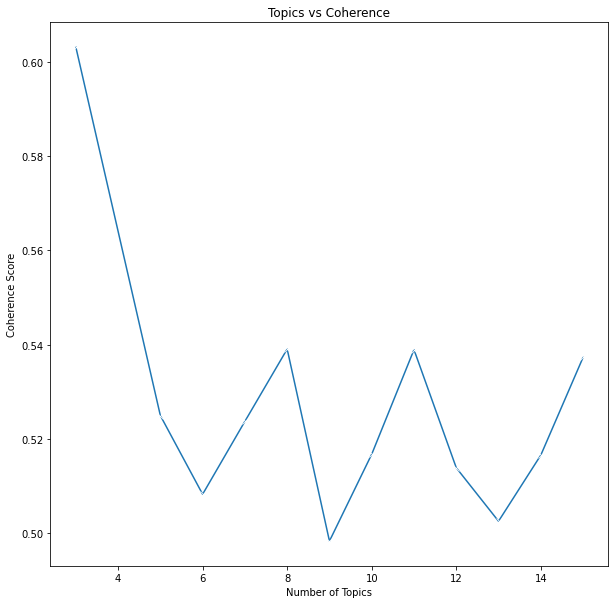

In [ ]:
import matplotlib.pyplot as plt
#matplotlib inline

plt.figure(figsize=(10,10))
sns.lineplot(num_topics, coherence_scores_pos, marker='x', palette='winter')
plt.title('Topics vs Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('Coherence Score')
plt.show()

##How does the topic distribution compare?

In [ ]:
ldamodel_lemma_pos_tuned = models.LdaModel(corpus_lemma_pos, num_topics = 11, id2word=dictionary_pos, passes=15, random_state=42)
topics = ldamodel_lemma_pos_tuned.print_topics(num_words=7)
for topic in topics:
    print(topic)

(0, '0.006*"stress" + 0.006*"trial" + 0.005*"patient" + 0.005*"fruit" + 0.004*"race" + 0.004*"artery" + 0.004*"temperature"')
(1, '0.006*"sword" + 0.005*"garden" + 0.005*"police" + 0.005*"gentleman" + 0.004*"silence" + 0.004*"priest" + 0.004*"doctor"')
(2, '0.015*"sister" + 0.008*"lady" + 0.006*"visit" + 0.006*"acquaintance" + 0.006*"daughter" + 0.006*"happiness" + 0.005*"affection"')
(3, '0.007*"plant" + 0.007*"king" + 0.005*"garden" + 0.005*"atom" + 0.005*"knife" + 0.004*"site" + 0.004*"ball"')
(4, '0.014*"cost" + 0.012*"cell" + 0.010*"data" + 0.008*"volume" + 0.007*"list" + 0.007*"procedure" + 0.007*"unit"')
(5, '0.014*"wine" + 0.011*"seed" + 0.010*"teeth" + 0.010*"foam" + 0.009*"frame" + 0.009*"plastic" + 0.008*"curve"')
(6, '0.010*"soul" + 0.007*"song" + 0.005*"poem" + 0.005*"ship" + 0.004*"thee" + 0.004*"shore" + 0.004*"star"')
(7, '0.032*"whale" + 0.020*"ship" + 0.017*"boat" + 0.007*"deck" + 0.006*"thou" + 0.006*"crew" + 0.005*"chapter"')
(8, '0.010*"guinea" + 0.009*"lady" + 0.0

In [ ]:
lda_display = pyLDAvis.gensim.prepare(ldamodel_lemma_pos_tuned, corpus_lemma_pos , dictionary_pos, sort_topics=False)
pyLDAvis.display(lda_display)

Thus, according to the data, 5 topics proves to be one of the most effective plots.

###Note: Upon modifications, 8 and 11 are strong contenders, so is 3, because it has the highest coherency, but I think it is a bit too low to encompass the variety of subjects. So, I have chosen 11, which seems to be optimal.

In [ ]:
sentence = ["In natural language understanding (NLU) tasks, there is a hierarchy of lenses through which we can extract meaning — from words to sentences to paragraphs to documents."]
def predict_topics(text,stop,topics):
  out=create_pipeline_pos(text,stop_eng)
  bow=[dictionary_pos.doc2bow(word) for word in out][0]
  topic_pred=ldamodel_lemma_pos_tuned.get_document_topics(bow)
  #print(topic_pred)
  topic_ids=[t[0] for t in topic_pred]
  likelihoods=[t[1] for t in topic_pred]
  ind=np.argmax(likelihoods)
  return topics[ind]



In [ ]:
predict_topics(sentence,stop_eng,topics_pos)


----
Document Name: In natural language understanding (NLU) tasks, there is a hierarchy of lenses through which we can extract meaning — from words to sentences to paragraphs to documents.

Cleaned: ['language', 'understanding', 'task', 'hierarchy', 'lens', 'word', 'sentence', 'document']


(9,
 '0.012*"student" + 0.009*"teacher" + 0.009*"education" + 0.009*"college" + 0.008*"community" + 0.006*"wage" + 0.006*"program"')

In [ ]:
sentence2=[" Indiana and his friend Marcus Brody (Denholm Elliott) are assigned by American businessman Walter Donovan (Julian Glover) to find the Holy Grail. They are teamed up with Dr. Elsa Schneider (Alison Doody), following on from where Indiana's estranged father Henry (Sean Connery) left off before he disappeared. It transpires that Donovan and Elsa are in league with the Nazis, who captured Henry Jones in order to get Indiana to help them find the Grail. However, Indiana recovers his father's diary filled with his research, and manages to rescue him before finding the location of the Grail."]

predict_topics(sentence2 ,stop_eng,topics_pos)


----
Document Name:  Indiana and his friend Marcus Brody (Denholm Elliott) are assigned by American businessman Walter Donovan (Julian Glover) to find the Holy Grail. They are teamed up with Dr. Elsa Schneider (Alison Doody), following on from where Indiana's estranged father Henry (Sean Connery) left off before he disappeared. It transpires that Donovan and Elsa are in league with the Nazis, who captured Henry Jones in order to get Indiana to help them find the Grail. However, Indiana recovers his father's diary filled with his research, and manages to rescue him before finding the location of the Grail.

Cleaned: ['friend', 'businessman', 'father', 'league', 'order', 'father', 'research', 'location']


(4,
 '0.037*"thee" + 0.032*"king" + 0.030*"thou" + 0.016*"hath" + 0.015*"shalt" + 0.014*"son" + 0.012*"offering"')

In [ ]:
sentence3=["The central character in the series is Harry Potter, a boy who lives in the fictional town of Little Whinging, Surrey with his aunt, uncle, and cousin – the Dursleys – and discovers at the age of eleven that he is a wizard, though he lives in the ordinary world of non-magical people known as Muggles.[8] The wizarding world exists parallel to the Muggle world, albeit hidden and in secrecy. His magical ability is inborn, and children with such abilities are invited to attend exclusive magic schools that teach the necessary skills to succeed in the wizarding world."]
predict_topics(sentence3 ,stop_eng,topics_pos)


----
Document Name: The central character in the series is Harry Potter, a boy who lives in the fictional town of Little Whinging, Surrey with his aunt, uncle, and cousin – the Dursleys – and discovers at the age of eleven that he is a wizard, though he lives in the ordinary world of non-magical people known as Muggles.[8] The wizarding world exists parallel to the Muggle world, albeit hidden and in secrecy. His magical ability is inborn, and children with such abilities are invited to attend exclusive magic schools that teach the necessary skills to succeed in the wizarding world.

Cleaned: ['character', 'series', 'town', 'aunt', 'uncle', 'cousin', 'discovers', 'eleven', 'wizard', 'world', 'people', 'wizarding', 'world', 'world', 'secrecy', 'ability', 'child', 'ability', 'magic', 'school', 'skill', 'wizarding', 'world']


(1,
 '0.007*"gentleman" + 0.006*"garden" + 0.006*"lady" + 0.005*"silence" + 0.005*"sword" + 0.004*"guinea" + 0.004*"police"')

#Part 8: Predictions

##8.1. Build topic index

In [ ]:
def build_index(corpus, stop):
  index_vals={}
  count=0
  for document in corpus:
    topic_max=predict_topics([document],stop,topics_pos)
    #print("Maximum likelihood topic:", topic_max)
    index_vals[count]=topic_max[0]
    count+=1
  return index_vals
    

In [ ]:
reference=build_index(document_joining(allfileids),stop_eng)


----
Document Name: Dan Morgan told himself he would forget Ann Turner . He was well rid of her . He certainly didn't want a wife who was fickle as Ann . If he had married her , he'd have been asking for trouble . But all of this was rationalization . Sometimes he woke up in the middle of the night thinking of Ann , and then could not get back to sleep . His plans and dreams had revolved around her so much and for so long that now he felt as if he had nothing . The easiest thing would be to sell out to Al Budd and leave the country , but there was a stubborn streak in him that wouldn't allow it . The best antidote for the bitterness and disappointment that poisoned him was hard work . He found that if he was tired enough at night , he went to sleep simply because he was too exhausted to stay awake . Each day he found himself thinking less often of Ann ; ; each day the hurt was a little duller , a little less poignant . He had plenty of work to do . Because the summer was unusually dry

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Cleaned: ['moses', 'genesis', 'beginning', 'heaven', 'earth', 'earth', 'form', 'void', 'darkness', 'face', 'face', 'water', 'light', 'light', 'light', 'darkness', 'darkness', 'evening', 'morning', 'firmament', 'midst', 'water', 'water', 'water', 'firmament', 'water', 'firmament', 'water', 'firmament', 'firmament', 'evening', 'morning', 'water', 'heaven', 'place', 'land', 'appear', 'land', 'gathering', 'together', 'water', 'earth', 'grass', 'herb', 'seed', 'fruit', 'tree', 'fruit', 'kind', 'seed', 'earth', 'earth', 'grass', 'herb', 'seed', 'kind', 'tree', 'fruit', 'seed', 'kind', 'evening', 'morning', 'light', 'firmament', 'heaven', 'night', 'sign', 'season', 'day', 'year', 'light', 'firmament', 'heaven', 'earth', 'light', 'light', 'light', 'night', 'star', 'firmament', 'heaven', 'earth', 'night', 'light', 'darkness', 'evening', 'morning', 'water', 'creature', 'life', 'fowl', 'earth', 'firmament', 'heaven', 'whale', 'living', 'creature', 'moveth', 'water', 'kind', 'fowl', 'kind', 'mult

In [ ]:
print(reference[241])

1


## 8.2 : Get user input and scrape wikipedia

In [ ]:
!pip install wikipedia

  Created wheel for wikipedia: filename=wikipedia-1.4.0-cp36-none-any.whl size=11686 sha256=673275f3fd8a6cb5d7de3bc6cb0b9503c59c5e5d91b753b834a09214aa8a41de
  Stored in directory: /root/.cache/pip/wheels/87/2a/18/4e471fd96d12114d16fe4a446d00c3b38fb9efcb744bd31f4a
Successfully built wikipedia


In [ ]:
import wikipedia

In [ ]:
query="Alice in Wonderland"
text=""

In [ ]:
possible_titles = ['Plot','Synopsis','Plot synopsis','Plot summary', 
             'Story','Plotline','The Beginning','Summary',
            'Content','Premise']
flag=0

In [ ]:
try:
  page=wikipedia.WikipediaPage(query)
  print("Success")
  flag=1
except:
  page=np.nan
  print("No such page exists")


Success


In [ ]:
if flag:
  try:
    for title in possible_titles:
      if page.section(title) != None:
          text = [page.section(title).replace('\n','').replace("\'","")]
          print("Found the section")
  except:
    text=np.nan
    print("No section for the same. Cannot process.")




Found the section


In [ ]:
topic=predict_topics(text,stop_eng,topics_pos)[0]


----
Document Name: Chapter One – Down the Rabbit Hole: Alice, a seven-year-old girl, is feeling bored and drowsy while sitting on the riverbank with her elder sister. She notices a talking, clothed white rabbit with a pocket watch run past. She follows it down a rabbit hole where she suddenly falls a long way to a curious hall with many locked doors of all sizes. She finds a little key to a door too small for her to fit through, but through it, she sees an attractive garden. She then discovers a bottle on a table labelled "DRINK ME," the contents of which cause her to shrink too small to reach the key which she had left on the table. She subsequently eats a cake labelled "EAT ME" in currants as the chapter closes.Chapter Two – The Pool of Tears: The chapter opens with Alice growing to such a tremendous size that her head hits the ceiling. Unhappy, Alice begins to cry and her tears literally flood the hallway. Shrinking down again due to a fan she had picked up, Alice swims through he

In [ ]:
nlp=spacy.load('en')
nlp.max_length = 10000000

In [ ]:

def get_most_similar(text,topic,dictionary, corpus):
  document_ids=[id for id in dictionary.keys() if dictionary[id]==topic]
  documents=[d for d in corpus]
  overall_similarities=[]
  text_string=' '.join(text)
  print("Topic:", topic)
  if len(document_ids)==0:
    for doc in documents:
      processed=nlp(doc)
      overall_similarities.append(nlp(text_string).similarity(processed))
  else:
    for id in document_ids:
      #print(documents[id])
      t=nlp(text_string)
      processed=nlp(documents[id])
      #print(type(documents[id]))
      overall_similarities.append(t.similarity(processed))
  ind=np.argmax(overall_similarities)
  return documents[ind]




In [ ]:
print("Most similar article to query:", query,"\n")
print(get_most_similar(text,topic,reference,document_joining(allfileids)))

Most similar article to query: Alice in Wonderland 

Topic: 2
Chairs scraped back and customers hastily vacated their tables as the tall young buffalo hunter pushed open the swing doors and walked towards the bar . Only Blue Throat and his gang stayed where they were . Blue Throat was slumped with his back against the bar , elbows supporting his massive frame . He leered at the stranger as the distance between them closed . `` Since when did they allow beardless kids into the saloon bars of this town , boys '' ? ? He asked . `` Seems to me I don't remember altering any law about that '' . He straightened up , alert now as the buffalo hunter came closer . `` Stay right here where you are , kid '' , he called . `` I don't aim to have minors breathing down my neck when I'm a-drinking '' : The stranger ignored him . He didn't stop till he was within three feet of Blue Throat and by that time the gang leader's right hand was on the butt of his revolver . `` I'm Billy Tilghman '' , said the 

For the above query, an adventure has been recommended.